In [262]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import h5py
import os,sys,glob, json
import _pickle as pkl
import dlab
from tqdm.notebook import tqdm
%matplotlib inline
%load_ext autoreload
%autoreload 2
plt.style.use('dark_background')


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Paths needed to be changed to your own paths

In [263]:
root_recording_folder ='/Volumes/T9/gradschool/rotations/jason_christie/sorted_recordings/Reach1_4_2024-02-13_18-20-36_001'
frontCam_events_txt = "/Volumes/T9/gradschool/rotations/jason_christie/behavior_videos/raw/20240213/christielab/session009/20240213_christielab_session009_events.txt"
frontCam_timestamps = "/Volumes/T9/gradschool/rotations/jason_christie/behavior_videos/raw/20240213/christielab/session009/20240213_christielab_session009_frontCam_timestamps.txt"
save_path_nwb = "/Volumes/T9/gradschool/rotations/jason_christie/analysis/Reach1_4_2024-02-13_18-20-36_001/Reach1_4_02122024nwb"
continous_path = "/Volumes/T9/gradschool/rotations/jason_christie/sorted_recordings/Reach1_4_2024-02-13_18-20-36_001/Record Node 103/experiment1/recording1/continuous"


In [264]:
recording_folder = root_recording_folder
stim_path = frontCam_events_txt
frame_path = frontCam_timestamps
nwb_path = save_path_nwb

### Load in raw recording data

In [265]:
recording_folder = recording_folder
# recording_folder = r'G:/Grant/rotation/2023-09-29_16-07-39_PaBont2'

experimenter = 'grh'
experiment_description= 'Chritie Lab, University of Colorado Anschutz. Test of reaching pertibation task, with mouse Reach1. Niave Mouse that could reach. recording from VA and M1, with probe B and Probe A respectively'

# #spikeglx
# probes = [os.path.basename(f) for f in np.sort(glob.glob(recording_folder+'/*-AP*'))]

probeids = ['A', 'B'] 
probedepths = [3000, 3000] 

### Read in .txt files with event times logged as frame numbers

In [266]:
stim_path = stim_path

# Create dictionaries to store the data
pellet_detected_data = {}
pellet_delivery_data = {}

# Open and read the text file
with open(stim_path, 'r') as file:
    lines = file.readlines()

# Iterate through the lines and parse the data
for line in lines:
    parts = line.strip().split('\t')
    if len(parts) == 2:
        name, value = parts
        value = int(value)
        if name == 'pellet_detected':
            if name in pellet_detected_data:
                pellet_detected_data[name].append(value)
            else:
                pellet_detected_data[name] = [value]
        elif name == 'pellet_delivery':
            if name in pellet_delivery_data:
                pellet_delivery_data[name].append(value)
            else:
                pellet_delivery_data[name] = [value]

pellet_detected_frame = pellet_detected_data['pellet_detected']
print("Pellet Detected Values:", pellet_detected_frame)
pellet_delivery_frame = pellet_delivery_data['pellet_delivery']
print("Pellet Delivery Values:", pellet_delivery_frame)


# Divide each value by 150
pellet_detected_seconds = [value / 150 for value in pellet_detected_frame]
pellet_delivery_seconds = [value / 150 for value in pellet_delivery_frame]
print('')
print('pellet detected real time seconds: ' , pellet_detected_seconds)
print('pellet delivery real time seconds: ' , pellet_delivery_seconds)


# Slow motion factor calculated from video. Because video is in slow motion need to convert times to match the video
slow_motion_factor = 4.994614744995619

pellet_delivery_slow_motion = [time * slow_motion_factor for time in pellet_detected_seconds]
pellet_detected_slow_motion = [time * slow_motion_factor for time in pellet_delivery_seconds]

print('')
print('pellet detected aligned to slow motion video: ' , pellet_detected_slow_motion)
print('pellet detected aligned to slow motion video: '  , pellet_delivery_slow_motion)
 
detected_slowmo_minutes_array = [seconds / 60 for seconds in pellet_detected_slow_motion]
delivery_slowmo_minutes_array = [seconds / 60 for seconds in pellet_delivery_slow_motion]

print('')
print('pellet detected aligned to slow motion video in minutes: ' , detected_slowmo_minutes_array)
print('pellet detected aligned to slow motion video in minutes: ' , delivery_slowmo_minutes_array)




Pellet Detected Values: [2765, 5465, 8133, 10799, 13467, 18385, 21050, 23750, 26421, 29085, 31784, 34447, 39360, 42063, 44763, 49198, 53592, 56269, 61185, 66102, 70603, 75518, 78190, 80893, 83559, 86224, 88924, 91629, 94299, 96968, 101888, 104587, 107437, 110076, 112739, 115410, 118076, 122998, 125666, 128368, 131070, 133771, 138689, 141362, 144062, 147105, 149808, 152509, 157432, 160092, 162943, 165607, 168312, 170978, 175898, 178597, 181269, 183969, 186673, 189335, 192041, 194711, 197382, 202302, 204967, 207667, 212591, 217507, 222431, 225130, 227835, 230502, 235452, 238114, 240820, 243518, 246218, 248920, 253839, 256506, 259173, 261837, 264541, 269460, 272161, 274825, 277494, 280157, 282824, 285492, 288161, 290862, 293532, 296203, 298907, 301575, 304240, 309190, 311890, 314595, 319506, 322211, 324914, 327577, 330247, 332949, 335652, 338356, 341027, 343691, 346391, 349065, 351765, 354430, 357131, 359793, 362463, 365130, 370081, 375036, 377700, 380360, 383064, 385767, 390679, 393379, 

### load in .txt file containing each frame number. stored as time between frame in nano-seconds

In [267]:
frame_path = frontCam_timestamps
# Initialize an empty list to store the numbers
frames = []

# Open and read the text file
with open(frame_path, 'r') as file:
    for line in file:
        number = int(line.strip())
        frames.append(number)

# Now, 'numbers' is a list containing all the numbers from the text file
print("Numbers Array:", frames)
print("total frames: ", len(frames))

# frame_numbers = [index + 1 for index in range(len(frames))]
frame_numbers = [(index + 1) / 150 for index in range(len(frames))]
frames_txt_file = [(index + 1) for index in range(len(frames))]



print('frame numbers: ', frame_numbers)
print('Recording Time Seconds:', len(frame_numbers)/150)
print('Recording Time Minutes:', len(frame_numbers)/150 / 60)





Numbers Array: [6667784, 6666488, 6667216, 6668000, 6666808, 6667088, 6667912, 6666624, 6667544, 6667024, 6667296, 6666920, 6668000, 6667464, 6667240, 6666920, 6667104, 6667512, 6666488, 6667840, 6667056, 6667488, 6666592, 6668024, 6666784, 6667728, 6666464, 6668024, 6666920, 6667032, 6667560, 6667272, 6666896, 6667832, 6666976, 6666896, 6667592, 6667024, 6666976, 6667376, 6667160, 6667920, 6667056, 6667592, 6666840, 6666784, 6667760, 6667048, 6667000, 6667976, 6666512, 6667544, 6667456, 6667032, 6667400, 6667080, 6666952, 6667920, 6666616, 6667952, 6667048, 6667488, 6666944, 6667248, 6666832, 6667920, 6667080, 6667000, 6667520, 6666616, 6667816, 6667000, 6667400, 6666600, 6667320, 6667168, 6667968, 6666784, 6667464, 6667344, 6666896, 6667104, 6667952, 6667352, 6666672, 6667896, 6667080, 6667048, 6666976, 6667864, 6666704, 6667456, 6667000, 6667816, 6666808, 6667376, 6666896, 6666944, 6667784, 6666896, 6667752, 6667248, 6667000, 6667456, 6667512, 6666648, 6667000, 6667408, 6667432, 666

### Plot the time between each frame, to see drop frames

total frame timestamps: 901117
recording duration seconds: 6007.446666666667


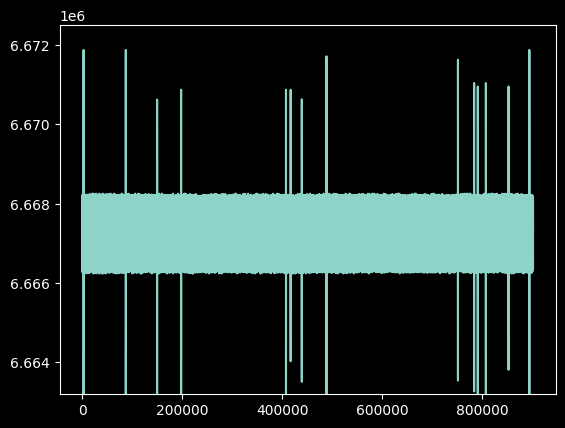

In [268]:
txt_file_frame_count = len(frames)
print("total frame timestamps:", txt_file_frame_count)
print("recording duration seconds:", txt_file_frame_count/150)
plt.ylim(6663200, 6672500)
plt.plot((frames))


### Load in the events data, logged in the digial lines of the openephys aquisition. and stored in the events folder of your recording

In [269]:
from open_ephys.analysis import Session

directory = recording_folder # for example
print(directory)

session = Session(directory)

/Volumes/T9/gradschool/rotations/jason_christie/sorted_recordings/Reach1_4_2024-02-13_18-20-36_001


In [270]:
events_df = pd.DataFrame(session.recordnodes[0].recordings[0].events)#

In [271]:
events_df

,line,sample_number,timestamp,processor_id,stream_index,stream_name,state
0,1,24942203,841.569485,100,0,ProbeA-AP,0
1,1,2078516,841.569487,100,1,ProbeA-LFP,0
2,7,25249877,841.569500,102,4,PXIe-6341,0
3,1,24942106,841.569519,100,2,ProbeB-AP,0
4,1,2078508,841.569533,100,3,ProbeB-LFP,0
...,...,...,...,...,...,...,...
969098,7,223896316,7463.117467,102,4,PXIe-6341,0
969099,1,18631077,7463.117581,100,1,ProbeA-LFP,0
969100,1,223572066,7463.117826,100,2,ProbeB-AP,0
969101,1,18631005,7463.117892,100,3,ProbeB-LFP,0


In [272]:
session.recordnodes[0].recordings[0].events

,line,sample_number,timestamp,processor_id,stream_index,stream_name,state
0,1,24942203,841.569485,100,0,ProbeA-AP,0
1,1,2078516,841.569487,100,1,ProbeA-LFP,0
2,7,25249877,841.569500,102,4,PXIe-6341,0
3,1,24942106,841.569519,100,2,ProbeB-AP,0
4,1,2078508,841.569533,100,3,ProbeB-LFP,0
...,...,...,...,...,...,...,...
969098,7,223896316,7463.117467,102,4,PXIe-6341,0
969099,1,18631077,7463.117581,100,1,ProbeA-LFP,0
969100,1,223572066,7463.117826,100,2,ProbeB-AP,0
969101,1,18631005,7463.117892,100,3,ProbeB-LFP,0


### Verify all event types are being recorded

In [273]:
probeA_LFP = events_df[events_df.stream_name == 'ProbeA-LFP' ]
probeA_LFP

,line,sample_number,timestamp,processor_id,stream_index,stream_name,state
1,1,2078516,841.569487,100,1,ProbeA-LFP,0
8,1,2079766,842.069526,100,1,ProbeA-LFP,1
13,1,2081016,842.569566,100,1,ProbeA-LFP,0
15,1,2082266,843.069606,100,1,ProbeA-LFP,1
23,1,2083516,843.569645,100,1,ProbeA-LFP,0
...,...,...,...,...,...,...,...
969082,1,18626077,7461.117422,100,1,ProbeA-LFP,0
969087,1,18627327,7461.617462,100,1,ProbeA-LFP,1
969089,1,18628577,7462.117501,100,1,ProbeA-LFP,0
969093,1,18629827,7462.616813,100,1,ProbeA-LFP,1


In [274]:
probeA_AP = events_df[events_df.stream_name == 'ProbeA-AP' ]
probeA_AP

,line,sample_number,timestamp,processor_id,stream_index,stream_name,state
0,1,24942203,841.569485,100,0,ProbeA-AP,0
7,1,24957203,842.069524,100,0,ProbeA-AP,1
12,1,24972203,842.569564,100,0,ProbeA-AP,0
18,1,24987203,843.069658,100,0,ProbeA-AP,1
22,1,25002203,843.569643,100,0,ProbeA-AP,0
...,...,...,...,...,...,...,...
969081,1,223512928,7461.117322,100,0,ProbeA-AP,0
969083,1,223527928,7461.616877,100,0,ProbeA-AP,1
969092,1,223542928,7462.117887,100,0,ProbeA-AP,0
969095,1,223557928,7462.616956,100,0,ProbeA-AP,1


In [275]:
ni_df = events_df[events_df.stream_name == 'PXIe-6341' ]
ni_df

,line,sample_number,timestamp,processor_id,stream_index,stream_name,state
2,7,25249877,841.569500,102,4,PXIe-6341,0
9,7,25264878,842.069533,102,4,PXIe-6341,1
14,7,25279879,842.569567,102,4,PXIe-6341,0
16,7,25294881,843.069633,102,4,PXIe-6341,1
24,7,25309882,843.569667,102,4,PXIe-6341,0
...,...,...,...,...,...,...,...
969080,7,223836311,7461.117300,102,4,PXIe-6341,0
969086,7,223851313,7461.617367,102,4,PXIe-6341,1
969088,7,223866314,7462.117400,102,4,PXIe-6341,0
969097,7,223881315,7462.617433,102,4,PXIe-6341,1


### Sync pulse is recorded on digital line 7, every half second

In [276]:
ni_df[ni_df['line'] == 7]


,line,sample_number,timestamp,processor_id,stream_index,stream_name,state
2,7,25249877,841.569500,102,4,PXIe-6341,0
9,7,25264878,842.069533,102,4,PXIe-6341,1
14,7,25279879,842.569567,102,4,PXIe-6341,0
16,7,25294881,843.069633,102,4,PXIe-6341,1
24,7,25309882,843.569667,102,4,PXIe-6341,0
...,...,...,...,...,...,...,...
969080,7,223836311,7461.117300,102,4,PXIe-6341,0
969086,7,223851313,7461.617367,102,4,PXIe-6341,1
969088,7,223866314,7462.117400,102,4,PXIe-6341,0
969097,7,223881315,7462.617433,102,4,PXIe-6341,1


### SideCam Frame numbers are recorded in the events folder on digital line 8, and the rest of the digial lines are made into veraibles below 


In [277]:
frame_events = ni_df[ni_df['line'] == 8]
frame_events


,line,sample_number,timestamp,processor_id,stream_index,stream_name,state
3010,8,34274000,1142.373526,102,4,PXIe-6341,1
3011,8,34274029,1142.374492,102,4,PXIe-6341,0
3012,8,34274231,1142.381226,102,4,PXIe-6341,1
3013,8,34274429,1142.387826,102,4,PXIe-6341,0
3014,8,34274631,1142.394559,102,4,PXIe-6341,1
...,...,...,...,...,...,...,...
965978,8,214548134,7151.511400,102,4,PXIe-6341,0
965979,8,214548335,7151.518100,102,4,PXIe-6341,1
965980,8,214548534,7151.524733,102,4,PXIe-6341,0
965981,8,214548735,7151.531433,102,4,PXIe-6341,1


In [278]:
frame_events_timestamp = frame_events.timestamp.values
frame_events_timestamp

array([1142.37352563, 1142.37449229, 1142.38122563, ..., 7151.52473333,
       7151.53143333, 7151.53806667])

In [279]:
tone1_2_events = ni_df[ni_df['line'] == 5]
tone1_2_events

,line,sample_number,timestamp,processor_id,stream_index,stream_name,state
5807,5,34798304,1159.850400,102,4,PXIe-6341,1
5809,5,34798460,1159.855600,102,4,PXIe-6341,0
5897,5,34814422,1160.387667,102,4,PXIe-6341,1
5899,5,34814579,1160.392900,102,4,PXIe-6341,0
8693,5,35338342,1177.851590,102,4,PXIe-6341,1
...,...,...,...,...,...,...,...
960803,5,213578233,7119.181367,102,4,PXIe-6341,0
963565,5,214096558,7136.458867,102,4,PXIe-6341,1
963567,5,214096715,7136.464100,102,4,PXIe-6341,0
963653,5,214112352,7136.985333,102,4,PXIe-6341,1


In [280]:
# extract every 2nd value from the array and make it a new array, do the same for the other array
tone1_events = tone1_2_events.iloc[::2, :]
tone2_events = tone1_2_events.iloc[1::2, :]

In [281]:
tone1_timestamp = tone1_events.timestamp.values
len(tone1_timestamp), tone1_timestamp[0:5]
tone1_timestamps = np.delete(tone1_timestamp, np.arange(1, tone1_timestamp.size, 2))
tone1_timestamps[0:5], len(tone1_timestamps)

(array([1159.8504    , 1177.85158998, 1195.63953333, 1213.416921  ,
        1231.20116667]),
 278)

In [282]:
tone2_event = ni_df[ni_df['line'] == 6]
tone2_event

,line,sample_number,timestamp,processor_id,stream_index,stream_name,state
5893,6,34814106,1160.377133,102,4,PXIe-6341,1
5895,6,34814263,1160.382367,102,4,PXIe-6341,0
8779,6,35354060,1178.375523,102,4,PXIe-6341,1
8780,6,35354217,1178.380757,102,4,PXIe-6341,0
11631,6,35887378,1196.152867,102,4,PXIe-6341,1
...,...,...,...,...,...,...,...
957913,6,213037786,7101.166467,102,4,PXIe-6341,0
960797,6,213577760,7119.165600,102,4,PXIe-6341,1
960799,6,213577917,7119.170833,102,4,PXIe-6341,0
963649,6,214112036,7136.974800,102,4,PXIe-6341,1


In [283]:
# make it so it only takes every other value in the tone2_event timestamp column and makes an array
tone2_timestamps = tone2_events['timestamp'].iloc[::2].values
tone2_timestamps[0:3], len(tone2_timestamps)

(array([1159.8556    , 1177.85682332, 1195.64476667]), 278)

In [284]:
optical_pulses_events = ni_df[ni_df['line'] == 4]
optical_pulses_events 


,line,sample_number,timestamp,processor_id,stream_index,stream_name,state


### using the number of rows recorded in the frame_events dataframe, we can calculate the total number of frames recorded, since each row is equivalent to one frame. we can use this to find total recording duration in seconds

In [285]:
row_numbers = np.arange(1, len(ni_df[ni_df['line'] == 8]) + 1)
open_ephys_frames = row_numbers
frames_in_seconds_open_ephys = np.array(row_numbers) / 150
frames_in_seconds_open_ephys[0:5]


array([0.00666667, 0.01333333, 0.02      , 0.02666667, 0.03333333])

### This shows the number of frames recoded by the camera in the open ephys. because the camera is recording at 150 fps, we can divide the frame number by 150 to get the time in seconds. and because i start the behavior camera and end the behvior camera begins after starting and ending the open ephys recording, there will be time in the open ephys recording before the frames start getting recorded.

In [286]:
open_ephys_frames_count = frame_events.shape[0]
print("number of frames recorded by open ephys:", open_ephys_frames_count)
print('number of frames recorded in txt file / total camera frames:', len(frames))

number of frames recorded by open ephys: 901220
number of frames recorded in txt file / total camera frames: 901117


In [287]:
extra_frames_counted_by_open_ephys =  open_ephys_frames_count - txt_file_frame_count
print("number of extra frames recorded by open-ephys:", extra_frames_counted_by_open_ephys)
print("seconds of extra frames recorded by open-ephys", extra_frames_counted_by_open_ephys/150)

number of extra frames recorded by open-ephys: 103
seconds of extra frames recorded by open-ephys 0.6866666666666666


### use the recorded frame event in the txt file and index into the corrisponding row of the frame_events dataframe and grab the time from the timestamp column. this gived you the aligned time in which the event occured, meaning you can use that time to plot the data, because it is syncronized with the neuropixel clocks

In [288]:
# print("Pellet Detected frame number:", pellet_detected_frame)
# print("Pellet Delivery frame number:", pellet_delivery_frame)

# print('')


# # Create new arrays to store the extracted timestamps
# detected_timestamps = []
# delivery_timestamps = []
# # Iterate through the frames in the 'pellet_detected_frame' array
# for frame in pellet_detected_frame:
#     # Use the frame value as an index to select the corresponding row
#     selected_row = frame_events.iloc[frame]
#     timestamp = selected_row['timestamp']
#     detected_timestamps.append(timestamp)

# # Iterate through the frames in the 'pellet_delivery_frame' array
# for frame in pellet_delivery_frame:
#     # Use the frame value as an index to select the corresponding row
#     selected_row = frame_events.iloc[frame]
#     timestamp = selected_row['timestamp']
#     delivery_timestamps.append(timestamp)

# # Now, 'detected_timestamps' and 'delivery_timestamps' contain the extracted timestamps
# print("Pellet Detected Timestamps:", detected_timestamps)
# print("Pellet Delivery Timestamps:", delivery_timestamps)
# print('total pellet delivery :', len(delivery_timestamps))
# print('total pellet detected :', len(detected_timestamps))



In [289]:
# # Divide each value by 150
# pellet_detected_seconds = [value / 150 for value in pellet_detected_frame_new]
# pellet_delivery_seconds = [value / 150 for value in pellet_delivery_frame_new]

# print("pellet_detected_seconds: ", pellet_detected_seconds)
# print("pellet_delivery_seconds: ", pellet_delivery_seconds)

# These are the aligned timestamps of the pellet detected and pellet delivery events
### use these when plotting neural data

In [290]:
# event_times_pellet_detetced = frame_events['timestamp'].iloc[pellet_detected_frame_new]
# print(event_times_pellet_detetced)

# event_times_pellet_delivery = frame_events['timestamp'].iloc[pellet_delivery_frame_new]
# event_times_pellet_delivery

### Plot the digital line inputs

In [291]:
ni_ts = {}
df_up = ni_df[ni_df.state==1]
for ch in ni_df.line.unique():
    ni_ts[ch] = df_up[df_up.line == ch].timestamp

## plot of digital events. Line 8 is the camera frame trigger, line 5 is the tone1 and tone2, line 6 is just tone2, line 4 is the optical pulses

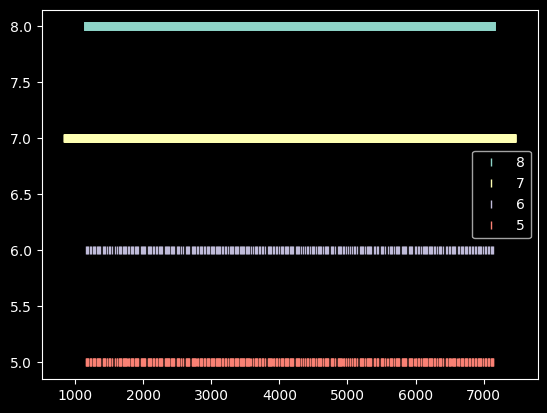

In [292]:
for ch in ([8,7,6,5]):
    # plt.xlim(65,75)
    plt.plot(np.array(ni_ts[ch]),
             np.ones(len(ni_ts[ch]))*ch,
             '|',label=ch)
plt.legend()


In [293]:
# Convert the values to float
pellet_detected_frame = [float(frame) for frame in pellet_detected_frame]
pellet_delivery_frame = [float(frame) for frame in pellet_delivery_frame]


In [294]:
# detected_baseline = pellet_detected_seconds[0:2]
# detected_perturbation = pellet_detected_seconds[2:4]
# detected_washout = pellet_detected_seconds[4:6]
# print(detected_baseline, detected_perturbation, detected_washout)

# pellet_detected_slow_motion_baseline = pellet_detected_slow_motion[0:2] 
# pellet_detected_slow_motion_perturbation = pellet_detected_slow_motion[2:4]
# pellet_detected_slow_motion_washout = pellet_detected_slow_motion[4:6]
# print(pellet_detected_slow_motion_baseline, pellet_detected_slow_motion_perturbation, pellet_detected_slow_motion_washout)



In [295]:
# delivery_baseline = pellet_delivery_seconds[0:2]
# delivery_perturbation = pellet_delivery_seconds[2:4]
# delivery_washout = pellet_delivery_seconds[4:6]
# print(delivery_baseline, delivery_perturbation, delivery_washout)

# pellet_delivery_slow_motion_baseline = pellet_delivery_slow_motion[0:2]
# pellet_delivery_slow_motion_perturbation = pellet_delivery_slow_motion[2:4]
# pellet_delivery_slow_motion_washout = pellet_delivery_slow_motion[4:6]
# pellet_delivery_slow_motion_baseline, pellet_delivery_slow_motion_perturbation, pellet_delivery_slow_motion_washout

In [332]:
len(tone1_timestamps), len(tone2_timestamps), tone1_timestamps[0:5], tone2_timestamps[0:5]

(278,
 278,
 array([1159.8504    , 1177.85158998, 1195.63953333, 1213.416921  ,
        1231.20116667]),
 array([1159.8556    , 1177.85682332, 1195.64476667, 1213.42215433,
        1231.20636667]))

In [297]:
stimuli_times = { 'pellet_delivery_seconds_txt': pellet_delivery_seconds,
                'pellet_detected_seconds_txt': pellet_detected_seconds,
                'pellet_delivery_slow_motion_txt': pellet_delivery_slow_motion,
                'pellet_detected_slow_motion_txt': pellet_detected_slow_motion,
                'pellet_detected_timestamp': tone1_timestamps,
                'pellet_delivery_timestamp': tone2_timestamps,
                'frame_events_timestamp': frame_events_timestamp,
                # 'pellet_delivery_baseline':delivery_baseline,
                # 'pellet_detected_perturbation':detected_perturbation,
                # 'pellet_delivery_perturbation':delivery_perturbation,
                # 'pellet_detected_washout':detected_washout,
                # 'pellet_delivery_washout':delivery_washout,
                # 'pellet_detected_slow_motion_baseline':pellet_delivery_slow_motion_baseline,
                # 'pellet_detected_slow_motion_perturbation':pellet_delivery_slow_motion_perturbation,
                # 'pellet_detected_slow_motion_washout':pellet_delivery_slow_motion_washout,
                'all_frames_sideCam_txt':frame_numbers,
                'frames_in_seconds_openEphys':frames_in_seconds_open_ephys,

                  }




### Conver values to floats, for code to work, idk why

In [298]:
# Convert the 'frames' values to float
stimuli_times['all_frames_sideCam'] = [float(frame) for frame in stimuli_times['all_frames_sideCam']]


# Now, the 'frames' values are in float format
print(stimuli_times['all_frames_sideCam'])

KeyError: 'all_frames_sideCam'

In [299]:


#stimulus list
stimuli = {'none': None,
           } 

## Assemble NWB

In [300]:
# !pip install pynwb
# !pip install numpy==1.24.3


In [301]:
import pynwb
from hdmf.backends.hdf5.h5_utils import H5DataIO
from hdmf.utils import StrDataset

In [302]:
from datetime import datetime
from dateutil.tz import tzlocal
from pynwb import NWBFile

nwbfile = NWBFile('Reaching Pertibation Task, Christie Lab, University of Colorado Anschutz. Mouse Reach1. Niave Mouse that could reach. recording from VA and M1, with probe B and Probe A respectively', 
                  recording_folder, 
                  datetime.now(tzlocal()),
                  experimenter=experimenter,
                  lab='Christie Lab',
                  institution='University of Colorado',
                  experiment_description=experiment_description,
                  session_id=os.path.basename(recording_folder))

add stimulus information

In [303]:
for stim in stimuli_times.keys():
    nwbfile.add_epoch(np.array(stimuli_times[stim])[0], 
                      np.array(stimuli_times[stim])[-1]+3.,
                      [stim])

In [304]:
nwbfile

,start_time,stop_time,tags
id,,,
0,17.940000,5996.500000,[pellet_delivery_seconds_txt]
1,18.433333,5997.006667,[pellet_detected_seconds_txt]
2,92.067398,29940.754079,[pellet_delivery_slow_motion_txt]
3,89.603389,29938.223474,[pellet_detected_slow_motion_txt]


In [305]:
nwbfile.add_trial_column('stimulus', 'the event occuring during this trial')

#optogenetic pertibation
nwbfile.add_trial_column('optogenetics_LED_state', 'whether or not the LED was on or off for this trial. 1=on,0=off. exact opto times are available in optogenetics_states field of NWB')


#arbMatrix and scene flicker
# nwbfile.add_trial_column('stimulus_index', 'index of each trial into a matrix or list of images')

stim_vals = {'optogenetics_LED_state':-1,
       
}
        
stim = 'all_frames_sideCam_txt'
for i,trial_start in enumerate(np.array(stimuli_times[stim])):
    nwbfile.add_trial(start_time=trial_start,  stop_time=trial_start, stimulus=stim,
                     optogenetics_LED_state=0,

                     )
    
stim = 'frames_in_seconds_openEphys'
for i,trial_start in enumerate(np.array(stimuli_times[stim])):
    nwbfile.add_trial(start_time=trial_start,  stop_time=trial_start, stimulus=stim,
                     optogenetics_LED_state=0,

                     )
    
stim = 'pellet_delivery_seconds_txt'
for i,trial_start in enumerate(np.array(stimuli_times[stim])):
    nwbfile.add_trial(start_time=trial_start,  stop_time=trial_start, stimulus=stim,
                     optogenetics_LED_state=0,

                     )
    
stim = 'pellet_detected_seconds_txt'
for i,trial_start in enumerate(np.array(stimuli_times[stim])):
    nwbfile.add_trial(start_time=trial_start,  stop_time=trial_start, stimulus=stim,
                     optogenetics_LED_state=0,

                     )
    
stim = 'pellet_delivery_slow_motion_txt'
for i,trial_start in enumerate(np.array(stimuli_times[stim])):
    nwbfile.add_trial(start_time=trial_start,  stop_time=trial_start, stimulus=stim,
                     optogenetics_LED_state=0,

                     )
    
stim = 'pellet_detected_slow_motion_txt'
for i,trial_start in enumerate(np.array(stimuli_times[stim])):
    nwbfile.add_trial(start_time=trial_start,  stop_time=trial_start, stimulus=stim,
                     optogenetics_LED_state=0,

                     )
    
stim = 'pellet_detected_timestamp'
for i,trial_start in enumerate(np.array(stimuli_times[stim])):
    nwbfile.add_trial(start_time=trial_start,  stop_time=trial_start, stimulus=stim,
                     optogenetics_LED_state=0,

                     )
    stim = 'pellet_delivery_timestamp'
for i,trial_start in enumerate(np.array(stimuli_times[stim])):
    nwbfile.add_trial(start_time=trial_start,  stop_time=trial_start, stimulus=stim,
                     optogenetics_LED_state=0,

                     )
    
    stim = 'frame_events_timestamp'
for i,trial_start in enumerate(np.array(stimuli_times[stim])):
    nwbfile.add_trial(start_time=trial_start,  stop_time=trial_start, stimulus=stim,
                     optogenetics_LED_state=0,

                     )

    

## Check the trials dataframe

In [306]:
df = nwbfile.trials.to_dataframe()


In [307]:
df

,start_time,stop_time,stimulus,optogenetics_LED_state
id,,,,
0,0.006667,0.006667,all_frames_sideCam_txt,0
1,0.013333,0.013333,all_frames_sideCam_txt,0
2,0.020000,0.020000,all_frames_sideCam_txt,0
3,0.026667,0.026667,all_frames_sideCam_txt,0
4,0.033333,0.033333,all_frames_sideCam_txt,0
...,...,...,...,...
2705220,7151.511400,7151.511400,frame_events_timestamp,0
2705221,7151.518100,7151.518100,frame_events_timestamp,0
2705222,7151.524733,7151.524733,frame_events_timestamp,0


In [329]:

pellet_delivery_data = df[df['stimulus'] == 'pellet_delivery_timestamp']
pellet_detected_data = df[df['stimulus'] == 'pellet_detected_timestamp']
pellet_delivery_slow_motion = df[df['stimulus'] == 'pellet_delivery_slow_motion_txt']
pellet_detected_slow_motion = df[df['stimulus'] == 'pellet_detected_slow_motion_txt']
all_frames_sideCam = df[df['stimulus'] == 'all_frames_sideCam_txt']
frames_in_seconds_openEphys = df[df['stimulus'] == 'frames_in_seconds_openEphys']


In [330]:
pellet_delivery_data

,start_time,stop_time,stimulus,optogenetics_LED_state
id,,,,
1803450,1177.851590,1177.851590,pellet_delivery_timestamp,0
1803451,1195.639533,1195.639533,pellet_delivery_timestamp,0
1803452,1213.416921,1213.416921,pellet_delivery_timestamp,0
1803453,1231.201167,1231.201167,pellet_delivery_timestamp,0
1803454,1263.997400,1263.997400,pellet_delivery_timestamp,0
...,...,...,...,...
1803723,7082.877400,7082.877400,pellet_delivery_timestamp,0
1803724,7100.645267,7100.645267,pellet_delivery_timestamp,0
1803725,7118.649467,7118.649467,pellet_delivery_timestamp,0


In [331]:
pellet_detected_data

,start_time,stop_time,stimulus,optogenetics_LED_state
id,,,,
1803449,1159.8504,1159.8504,pellet_detected_timestamp,0


In [311]:
all_frames_sideCam

,start_time,stop_time,stimulus,optogenetics_LED_state
id,,,,
0,0.006667,0.006667,all_frames_sideCam_txt,0
1,0.013333,0.013333,all_frames_sideCam_txt,0
2,0.020000,0.020000,all_frames_sideCam_txt,0
3,0.026667,0.026667,all_frames_sideCam_txt,0
4,0.033333,0.033333,all_frames_sideCam_txt,0
...,...,...,...,...
901112,6007.420000,6007.420000,all_frames_sideCam_txt,0
901113,6007.426667,6007.426667,all_frames_sideCam_txt,0
901114,6007.433333,6007.433333,all_frames_sideCam_txt,0


In [312]:
frames_in_seconds_openEphys

,start_time,stop_time,stimulus,optogenetics_LED_state
id,,,,
901117,0.006667,0.006667,frames_in_seconds_openEphys,0
901118,0.013333,0.013333,frames_in_seconds_openEphys,0
901119,0.020000,0.020000,frames_in_seconds_openEphys,0
901120,0.026667,0.026667,frames_in_seconds_openEphys,0
901121,0.033333,0.033333,frames_in_seconds_openEphys,0
...,...,...,...,...
1802332,6008.106667,6008.106667,frames_in_seconds_openEphys,0
1802333,6008.113333,6008.113333,frames_in_seconds_openEphys,0
1802334,6008.120000,6008.120000,frames_in_seconds_openEphys,0


## add optogenetics

In [313]:

# opto_on_times = delivery_pert_df['start_time'].to_numpy()
# opto_off_times = [value + 0.1 for value in opto_on_times]

# opto_on_times, opto_off_times


In [314]:
# frame_events 

# opto_off_times = detected_pert_df[camera_df.state==0].timestamp
# opto_on_times = camera_df[camera_df.state==1].timestamp

In [315]:
# opto_states = pynwb.epoch.TimeIntervals(
#     name="optogenetics_states",
#     description="intervals for optical fiber, fiber at power = ?? on what system. fiber 470nm, ",
# )

# opto_states.add_column(name="power", description="15mW")
# opto_states.add_column(name="wavelength", description="470nm")

# for i in range(np.array(opto_off_times).shape[0]):
#     opto_states.add_row(start_time=np.array(opto_on_times)[i], stop_time=np.array(opto_off_times)[i], power=1.5, wavelength=565)

# nwbfile.add_time_intervals(opto_states)

### add ephys data
first add electrodes and raw data link

In [316]:
from dlab.nwbtools import df_from_phy, load_phy_template, option234_positions, multi_load_unit_data


In [317]:
recording_folder = continous_path
# recording_folder= '/Volumes/T9/gradschool/rotations/jason_christie/sorted_recordings/Reach1_4_2024-02-13_18-20-36_001/'
recording_folder

'/Volumes/T9/gradschool/rotations/jason_christie/sorted_recordings/Reach1_4_2024-02-13_18-20-36_001/Record Node 103/experiment1/recording1/continuous'

In [318]:
import os

recording_folder = continous_path  # Make sure this is your intended folder
print("Looking in:", recording_folder)
print("Contents:", os.listdir(recording_folder))

Looking in: /Volumes/T9/gradschool/rotations/jason_christie/sorted_recordings/Reach1_4_2024-02-13_18-20-36_001/Record Node 103/experiment1/recording1/continuous
Contents: ['Neuropix-PXI-100.ProbeA-LFP', 'Neuropix-PXI-100.ProbeB-LFP', 'NI-DAQmx-102.PXIe-6341', 'Neuropix-PXI-100.ProbeA-AP', 'Neuropix-PXI-100.ProbeB-AP']


### For some reason running multi_load_unit_data() from dlabs.nwbtools is not working. so i had to copy over the function and run it here. that is what the big cell below is for. ignore it, it just allows the df_units to run undernearh it

In [319]:
import numpy as np
import pandas as pd
import warnings
import glob, os, h5py, csv
from dlab.generalephys import option234_positions
from dlab.sglx_analysis import readAPMeta
import dlab.continuous_traces as ct

try:
	from nwb.nwb import NWB
	from nwb.nwbts import TimeSeries
except:
	print('no Allen Institute NWB API. get this from http://stash.corp.alleninstitute.org/projects/INF/repos/ainwb/browse')
try:
	from djd.OpenEphys import loadContinuous, loadFolder, load_kwik_klusters
except:
	try:
		from OpenEphys import loadContinuous, loadFolder, load_kwik_klusters
	except:
		print('no OpenEphys.py get this from https://github.com/open-ephys/analysis-tools')

warnings.simplefilter(action='ignore', category=FutureWarning)
		
def load_phy_template(path,cluster_file='KS2',site_positions = option234_positions, **kwargs):
	"""load spike data that has been manually sorted with the phy-template GUI

    Parameters
    ----------
    path : string
        the path to the sorted data
    cluster_file : string, optional
        the format of the cluter_info file. options, KS2, KS3
    site_positions : np.array, optional
        the geometry of the sites on the array. n x 2, where n is the number of channels. the site_positions should contain coordinates of the channels in probe space. for example, in um on the face of the probe

    Returns
    -------
    dict
		returns a dictionary of 'good' units, each of which includes:
			times: spike times, in seconds
			template: template used for matching
			ypos: y position on the probe, calculated from the template. requires an accurate site_positions. averages template from 100 spikes.
			xpos: x position on the probe, calcualted from the template. requires an accurate site_positions. averages template from 100 spikes.
	""" 
	clusters = np.load(open(os.path.join(path,'spike_clusters.npy'),'rb'))
	spikes = np.load(open(os.path.join(path,'spike_times.npy'),'rb'))
	spike_templates = np.load(open(os.path.join(path,'spike_templates.npy'),'rb'))
	templates = np.load(open(os.path.join(path,'templates.npy'),'rb'))
	cluster_id,KSlabel,KSamplitude,KScontamination = [],[],[],[]
	[KSlabel.append(row) for row in csv.reader(open(os.path.join(path,'cluster_KSLabel.tsv')))]
	[KSamplitude.append(row) for row in csv.reader(open(os.path.join(path,'cluster_Amplitude.tsv')))]
	[KScontamination.append(row) for row in csv.reader(open(os.path.join(path,'cluster_ContamPct.tsv')))]
	if os.path.isfile(os.path.join(path,'cluster_group.tsv')):
		# cluster_id = [row for row in csv.reader(open(os.path.join(path,'cluster_group.tsv')))][1:]
		[cluster_id.append(row) for row in csv.reader(open(os.path.join(path,'cluster_group.tsv')))]
	else:
		if os.path.isfile(os.path.join(path,'cluster_groups.csv')):
			# cluster_id = [row for row in csv.reader(open(os.path.join(path,'cluster_groups.csv')))][1:]
			[cluster_id.append(row) for row in csv.reader(open(os.path.join(path,'cluster_groups.csv')))]
		else: print('cant find cluster groups, either .tsv or .csv')
	if 'sampling_rate' in kwargs.keys():
		samplingrate = kwargs['sampling_rate']
	else:
		samplingrate =30000.
		# print('no sampling rate specified, using default of 30kHz')
		
	units = {}
	for i in np.arange(1,np.shape(cluster_id)[0]):
		unit = int(cluster_id[i][0].split('\t')[0])
		units[str(unit)] = {}
		
		#get the unit spike times
		units[str(unit)]['samples'] = spikes[np.where(clusters==unit)].flatten()
		units[str(unit)]['times'] = spikes[np.where(clusters==unit)]/samplingrate
		units[str(unit)]['times'] = units[str(unit)]['times'].flatten()
		
		#get the mean template used for this unit
		all_templates = spike_templates[np.where(clusters==unit)].flatten()
		n_templates_to_subsample = 100
		random_subsample_of_templates = templates[all_templates[np.array(np.random.rand(n_templates_to_subsample)*all_templates.shape[0]).astype(int)]]
		mean_template = np.mean(random_subsample_of_templates,axis=0)
		units[str(unit)]['template'] = mean_template
		
		#take a weighted average of the site_positions, where the weights is the absolute value of the template for that channel
		#this gets us the x and y positions of the unit on the probe.
		# print(mean_template.T.shape)
		weights = np.zeros(site_positions.shape)
		for channel in range(mean_template.T.shape[0]):
			weights[channel,:]=np.trapz(np.abs(mean_template.T[channel,:]))
		weights = weights/np.max(weights)
		low_values_indices = weights < 0.25  # Where values are low,
		weights[low_values_indices] = 0      # make the weight 0
		(xpos,ypos)=np.average(site_positions,axis=0,weights=weights)
		units[str(unit)]['waveform_weights'] = weights
		units[str(unit)]['xpos'] = xpos
		units[str(unit)]['ypos'] = ypos #- site_positions[-1][1]
		units[str(unit)]['label'] =  cluster_id[i][0].split('\t')[1]
		units[str(unit)]['KSlabel'] =  KSlabel[i][0].split('\t')[1]
		units[str(unit)]['KSamplitude'] =  KSamplitude[i][0].split('\t')[1]
		units[str(unit)]['KScontamination'] =  KScontamination[i][0].split('\t')[1]
	return units

def df_from_phy(path,site_positions = option234_positions,**kwargs):
	"""load spike data that has been manually sorted with the phy-template GUI

    Parameters
    ----------
    path : string
        the path to the sorted data
    cluster_file : string, optional
        the format of the cluter_info file. options, KS2, KS3
    site_positions : np.array, optional
        the geometry of the sites on the array. n x 2, where n is the number of channels. the site_positions should contain coordinates of the channels in probe space. for example, in um on the face of the probe

    Returns
    -------
    pandas DataFrame
		returns a DataFrame of 'good' units, each of which includes:
	"""
	nwb_data = load_phy_template(path,site_positions)
	#structures is a dictionary that defines the bounds of the structure e.g.:{'v1':(0,850), 'hpc':(850,2000)}
	mouse = [];experiment=[];cell = [];ypos = [];xpos = [];waveform=[];template=[];structure=[];times=[]
	index = []; count = 1
	nwb_id = [];probe_id=[]
	depth=[];#print(list(nwb_data.keys()));print(list(nwb_data['processing'].keys()));
	if 'probe' in kwargs.keys():
		for probe in list(nwb_data['processing'].keys()):
			if 'UnitTimes' in list(nwb_data['processing'][probe].keys()): 
				for i,u in enumerate(list(nwb_data['processing'][probe]['UnitTimes'].keys())):
					if u != 'unit_list':
						nwb_id.append(nwbid)
						probe_id.append(probe)
						index.append(count);count+=1
						mouse.append(str(np.array(nwb_data.get('identifier'))))
						experiment.append(1)
						cell.append(u)
						times.append(np.array(nwb_data['processing'][probe]['UnitTimes'][u]['times']));# print(list(nwb_data['processing'][probe]['UnitTimes'][u].keys()))
						if 'ypos' in list(nwb_data['processing'][probe]['UnitTimes'][u].keys()):
							ypos.append(np.array(nwb_data['processing'][probe]['UnitTimes'][u]['ypos']))
							has_ypos = True
						else:
							ypos.append(None)
							has_ypos = False				
						if 'depth' in list(nwb_data['processing'][probe]['UnitTimes'][u].keys()):
							depth.append(np.array(nwb_data['processing'][probe]['UnitTimes'][u]['depth']))
						else:
							if has_ypos:
								depth.append(np.array(nwb_data['processing'][probe]['UnitTimes'][u]['ypos']))
							else:
								depth.append(None)
						if 'xpos' in list(nwb_data['processing'][probe]['UnitTimes'][u].keys()):
							xpos.append(np.array(nwb_data['processing'][probe]['UnitTimes'][u]['xpos']))
							has_xpos = True
						else:
							xpos.append(None)
							has_xpos = False
						template.append(np.array(nwb_data['processing'][probe]['UnitTimes'][u]['template']))
						waveform.append(get_peak_waveform_from_template(template[-1]))
						if not structures == None:
							structur = None
							for struct, bounds in structures.iteritems():
								if ypos[-1] > bounds[0] and ypos[-1]< bounds[1] :
									structur=struct
						else:
							structur = None
						structure.append(structur)
	df = pd.DataFrame(index=index)
	df = df.fillna(np.nan)
	df['nwb_id'] = nwb_id
	df['mouse'] = mouse
	df['experiment'] = experiment
	df['probe'] = probe_id
	df['structure'] = structure
	df['cell'] = cell
	df['times'] = times
	df['ypos'] = ypos
	df['xpos'] = xpos
	df['depth'] = depth
	df['waveform'] = waveform
	df['template'] = template
	return df

def load_unit_data(recording_path, probe_depth = 3840, site_positions = option234_positions, 
                   probe_name=None, spikes_filename = 'spike_secs.npy', aligned=True, df=True, **kwargs):
	"""DEPRECATED
	
	"""
	if probe_name == None: probe_name = recording_path
    #Get individual folders for each probe
	unit_times=[]
	if aligned == False:
		if 'sampling_rate' in kwargs.keys():
			sampRate  = float(kwargs['sampling_rate'])
		else:
			sampRate=30000
		spike_times = np.ndarray.flatten(np.load(os.path.join(recording_path, 'spike_times.npy')))/sampRate
	else:
		spike_times = np.ndarray.flatten(np.load(os.path.join(recording_path, spikes_filename)))

	cluster_info = pd.read_csv(os.path.join(recording_path, 'cluster_info.tsv'), '\t')
	if cluster_info.keys()[0]=='cluster_id':
		cluster_info = cluster_info.rename(columns={'cluster_id':'id'})
	spike_clusters = np.ndarray.flatten(np.load(os.path.join(recording_path, 'spike_clusters.npy')))
	spike_templates = np.load(open(os.path.join(recording_path,'spike_templates.npy'),'rb'))
	templates = np.load(open(os.path.join(recording_path,'templates.npy'),'rb'))
	amplitudes = np.load(open(os.path.join(recording_path,'amplitudes.npy'),'rb'))
	weights = np.zeros(site_positions.shape)

    #Generate Unit Times Table
	for index, unitID in enumerate(cluster_info['id'].values):
        #get mean template used for each unit
		all_templates = spike_templates[np.where(spike_clusters==unitID)].flatten()
		n_templates_to_subsample = 100
		random_subsample_of_templates = templates[all_templates[np.array(np.random.rand(n_templates_to_subsample)*all_templates.shape[0]).astype(int)]]
		mean_template = np.mean(random_subsample_of_templates,axis=0)

        #take a weighted average of the site_positions, where the weights is the absolute value of the template for that channel
        #this gets us the x and y positions of the unit on the probe.
		for channel in range(mean_template.T.shape[0]):
			weights[channel,:]=np.trapz(np.abs(mean_template.T[channel,:]))
		weights = weights/np.max(weights)
		low_values_indices = weights < 0.25  # Where values are low,
		weights[low_values_indices] = 0      # make the weight 0
		(xpos,zpos)=np.average(site_positions,axis=0,weights=weights)

		unit_times.append({'probe':probe_name,
                           'unit_id': unitID,
                           'group': cluster_info.group[index],
#                                'depth':cluster_info.depth[index],
                           'depth': (zpos-3840)+probe_depth,
                           'xpos': xpos,
                           'zpos': zpos,
                           'no_spikes': cluster_info.n_spikes[index], 
                           'KSlabel': cluster_info['KSLabel'][index],
                           'KSamplitude':cluster_info.Amplitude[index],
                           'KScontamination': cluster_info.ContamPct[index],
                           'template': mean_template,
                           'waveform_weights': weights,
                           'amplitudes': amplitudes[:,0][spike_clusters==unitID],
                           'times': spike_times[spike_clusters == unitID],
                            })
	if df == True:        
		unit_data = pd.DataFrame(unit_times)
        #Remove clusters with no associated spike times left over from Phy
		for i,j in enumerate(unit_data.times):
			if len(unit_data.times[i])==0:
				unit_data.times[i]='empty'
		unit_times = unit_data[unit_data.times!='empty']
		return(unit_times)
	else:
		return(unit_times)

def load_unit_data_from_phy(recording_path,chanmap=None,insertion_depth = 3840,insertion_angle = 0):	
	"""requires that phy has been run to generate cluster_info.tsv
	   searches the folder for the chanmap the KS used, or searches one folder up for it

    Parameters
    ----------
    recording_path : string
        the path to the sorted data
    chanmap : np.array, optional
        the geometry of the sites on the array. n x 2, where n is the number of channels. the site_positions should contain coordinates of the channels in probe space. for example, in um on the face of the probe
    insertion_depth : int, optional
        the depth in microns of the insertion
    insertion_depth : int, optional
        the angle, away from normal to the brain surface, of the insertion. used in calculating depth from puea

    Returns
    -------
    cluster_info : dict
		returns a dictionary of 'good' units
	""" 
	cluster_info = pd.read_csv(os.path.join(recording_path, 'cluster_info.tsv'), '\t')
	if cluster_info.keys()[0]=='cluster_id':
		cluster_info = cluster_info.rename(columns={'cluster_id':'id'})
	spike_clusters = np.ndarray.flatten(np.load(os.path.join(recording_path, 'spike_clusters.npy')))
	spike_templates = np.load(open(os.path.join(recording_path,'spike_templates.npy'),'rb'))
	templates = np.load(open(os.path.join(recording_path,'templates.npy'),'rb'))
	spike_times = np.load(open(os.path.join(recording_path,'spike_times.npy'),'rb'))
	timestamps = np.load(open(os.path.join(recording_path,'timestamps.npy'),'rb'))
	spike_secs = timestamps[spike_times.flatten()]

    #parse spike times for each unit. also get the template so we can use it for waveform shape clustering
	times = []
	mean_templates = []
	for unitID in cluster_info.id.values:
		times.append(spike_secs[spike_clusters == unitID])

		all_templates = spike_templates[np.where(spike_clusters==unitID)].flatten()
		if len(all_templates) > 100:
			n_templates_to_subsample = 100
		else: n_templates_to_subsample = len(all_templates)
		random_subsample_of_templates = templates[all_templates[np.array(np.random.rand(n_templates_to_subsample)*all_templates.shape[0]).astype(int)]]
		mean_template = np.mean(random_subsample_of_templates,axis=0)
		mean_templates.append(mean_template)
	cluster_info['times'] = times
	cluster_info['template'] = mean_templates
	cluster_info['depth_from_pia']=cluster_info.depth.values * -1 + insertion_depth*np.cos(np.deg2rad(insertion_angle))

	if chanmap == None:
		try:
			chanmap = loadmat(glob.glob(os.path.join(recording_path,'*hanMap.mat'))[0])
		except:
			chanmap = loadmat(glob.glob(os.path.join(os.path.dirname(recording_path),'*hanMap.mat'))[0])

	cluster_info['ycoords'] = chanmap['ycoords'].flatten()[cluster_info.ch.values]
	cluster_info['xcoords'] = chanmap['xcoords'].flatten()[cluster_info.ch.values]
	cluster_info['shank'] = np.floor(cluster_info['xcoords'].values / 205.).astype(int)

	return cluster_info

def make_spike_secs(probe_folder):
	"""if a times of spikes, in seconds, have not been calculated (only samples), creates spike_secs.npy

    Parameters
    ----------
    probe_folder : string
        the path to the  folder containing sorted data and raw data

    Returns
    -------
     None
	 saves, the probe_folder input, a new file called spike)secs.npy
	""" 

	c = np.load(os.path.join(probe_folder,'spike_times.npy'))
	try:
		a = np.load(os.path.join(probe_folder,'timestamps.npy'))
	except:
		try:
			a = np.load(os.path.join(probe_folder,'new_timestamps','timestamps.npy'))
		except: 
			try:
				print('could not find timestamps.npy, trying to recreate from the sync TTLs for '+probe_folder)
				ct.recreate_probe_timestamps_from_TTL(probe_folder)
				a = np.load(os.path.join(probe_folder,'new_timestamps','timestamps.npy'))
			except: print('could not find timestamps.npy')
	try:
		spike_secs = a[c.flatten()[np.where(c.flatten()<a.shape[0])]]
	except: 
		print(np.shape(a))
		print(np.shape(c.flatten()))
		print(np.shape(c))
		print('shape of spike times annd timestamps not compatible, check above and investigate.')
	np.save(open(os.path.join(probe_folder,'spike_secs.npy'),'wb'),spike_secs)

def multi_load_unit_data(recording_folder,probe_names=['A','B','C','D'],probe_depths=[3840,3840,3840,3840],spikes_filename = 'spike_secs.npy', aligned=True):
	"""requires that phy has been run to generate cluster_info.tsv
	   searches the folder for the chanmap the KS used, or searches one folder up for it

    Parameters
    ----------
    recording_folder : string
        the path to the parent folder containing multiple simultaneous recordings. each folder contains sorted data
	probe_names : tuple-like, containing strings
        the names of the probes in the recording folder
	probe_depths : tuple-like, containing ints
        the depths of insertion of the probes in the recording folder
    spikes_filename : string, optional
        the name of the file containg times for each spike. default: 'spike_secs.npy'
    aligned : bool, optional
        whether the probes are temporally aligned. default True

    Returns
    -------
     : pandas DataFrame
		a DataFrame containing good units from all recordings. also adds a column for probe of origin based on the `probe_names` input
	""" 

	folder_paths = glob.glob(os.path.join(recording_folder,'*imec*'))
	if len(folder_paths) > 0: spikes_filename = 'spike_secs.npy'
	else:
		folder_paths = glob.glob(os.path.join(recording_folder,'*AP*'))
		if len(folder_paths) > 0: 
			for probe_folder in folder_paths: make_spike_secs(probe_folder)
		else:
			print('did not find any recordings in '+recording_folder+'')
			return
	return pd.concat([load_unit_data(folder,probe_name=probe_names[i],probe_depth=probe_depths[i],spikes_filename = spikes_filename, aligned=True,df=True) for i,folder in enumerate(folder_paths)],ignore_index=True)

no Allen Institute NWB API. get this from http://stash.corp.alleninstitute.org/projects/INF/repos/ainwb/browse
no OpenEphys.py get this from https://github.com/open-ephys/analysis-tools


In [320]:
df_units = multi_load_unit_data(recording_folder,probe_depths=probedepths)
df_units.iloc[0]

probe                                                               A
unit_id                                                             0
group                                                           noise
depth                                                     2949.888907
xpos                                                              5.0
zpos                                                      3789.888907
no_spikes                                                       11303
KSlabel                                                           mua
KSamplitude                                                    1725.2
KScontamination                                                 266.0
template            [[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...
waveform_weights    [[0.5732324719429016, 0.5732324719429016], [0....
amplitudes          [15.987212181091309, 16.863000869750977, 19.52...
times               [855.3421734879887, 855.7147579627439, 856.202...
Name: 0, dtype: obje

In [321]:
probes = ['A','B']
locations = ['M1','VA']
descriptions = ['Neuropixels1.0','Neuropixels1.0'] 

In [322]:
device = nwbfile.create_device(name='ChristieLab Rig_2')

for i, probe in enumerate(probes):
    electrode_name = 'probe'+str(i)
    description = descriptions[i]
    location = locations[i]

    electrode_group = nwbfile.create_electrode_group(electrode_name,
                                                     description=description,
                                                     location=location,
                                                     device=device)
    for ch in range(option234_positions.shape[0]):
        nwbfile.add_electrode(x=option234_positions[ch,0],y=0.,z=option234_positions[0,1],imp=0.0,location='none',filtering='high pass 300Hz',group=electrode_group)
    
#     if len(glob.glob(os.path.join(recording_folder,probes[1])+'/*lf.b*')) > 0:
#         ephys_ts = pynwb.ecephys.ElectricalSeries('lfp_probe'+probeids[i],
#                                 data=H5DataIO(data=StrDataset(glob.glob(os.path.join(recording_folder,probes[1])+'/*lf.b*')[0]),    
#                                         link_data=True),
#                                 electrodes = electrode_group,
#                                 starting_time=0,
#                                 rate=2500,
#                                 resolution=0.001,
#                                 comments="V1, depth = 1500um",
#                                 description="V1, depth = 1500um")
#         nwbfile.add_acquisition(ephys_ts)

In [323]:
nwbfile

root pynwb.file.NWBFile at 0x140521436891984
Fields:
  devices: {
    ChristieLab Rig_2 <class 'pynwb.device.Device'>
  }
  electrode_groups: {
    probe0 <class 'pynwb.ecephys.ElectrodeGroup'>,
    probe1 <class 'pynwb.ecephys.ElectrodeGroup'>
  }
  electrodes: electrodes <class 'hdmf.common.table.DynamicTable'>
  epoch_tags: {
    all_frames_sideCam_txt,
    frame_events_timestamp,
    frames_in_seconds_openEphys,
    pellet_delivery_seconds_txt,
    pellet_delivery_slow_motion_txt,
    pellet_delivery_timestamp,
    pellet_detected_seconds_txt,
    pellet_detected_slow_motion_txt,
    pellet_detected_timestamp
  }
  epochs: epochs <class 'pynwb.epoch.TimeIntervals'>
  experiment_description: Chritie Lab, University of Colorado Anschutz. Test of reaching pertibation task, with mouse Reach1. Niave Mouse that could reach. recording from VA and M1, with probe B and Probe A respectively
  experimenter: ['grh']
  file_create_date: [datetime.datetime(2024, 2, 16, 11, 32, 2, 858715, tzinfo=tzlocal())]
  identifier: /Volumes/T9/gradschool/rotations/jason_christie/sorted_recordings/Reach1_4_2024-02-13_18-20-36_001
  institution: University of Colorado
  lab: Christie Lab
  session_description: Reaching Pertibation Task, Christie Lab, University of Colorado Anschutz. Mouse Reach1. Niave Mouse that could reach. recording from VA and M1, with probe B and Probe A respectively
  session_id: Reach1_4_2024-02-13_18-20-36_001
  session_start_time: 2024-02-16 11:32:02.857799-07:00
  timestamps_reference_time: 2024-02-16 11:32:02.857799-07:00
  trials: trials <class 'pynwb.epoch.TimeIntervals'>

In [324]:
# nwbfile.add_unit_column('location', 'the anatomical location of this unit')
# nwbfile.add_unit_column('quality', 'the quality for the inference of this unit')
# nwbfile.add_unit_column('quality_ISIviolations', 'the quality for the inference of this unit')
# nwbfile.add_unit_column('quality_sn', 'the quality for the inference of this unit')
# nwbfile.add_unit_column('quality_distance', 'the quality for the inference of this unit')

nwbfile.add_unit_column('depth', 'the depth of this unit from the pia')
nwbfile.add_unit_column('xpos', 'the x position on probe')
nwbfile.add_unit_column('ypos', 'the y position on probe')
# nwbfile.add_unit_column('template', 'Kilosort template')
nwbfile.add_unit_column('label', 'user label')
nwbfile.add_unit_column('KSlabel', 'Kilosort label')
nwbfile.add_unit_column('KSamplitude', 'Kilosort amplitude')
nwbfile.add_unit_column('KScontamination', 'Kilosort ISI contamination')
nwbfile.add_unit_column('probe', 'probe ID')

labels =np.array(['noise','mua','good'])

for i,unit_row in df_units.iterrows():
    try: lbl = np.argwhere(unit_row.group==labels)[0][0]
    except: lbl=0
    try: klbl = np.argwhere(unit_row.KSlabel==labels)[0][0]
    except: klbl=0
    nwbfile.add_unit(id=int(unit_row.name), 
                     spike_times=unit_row.times,
                    #  electrodes = np.where(unit_row.waveform_weights > 0)[0],
                    #  waveform_mean = unit_row.template,
# #                       quality=0.95
                     depth = unit_row.depth,
                     xpos= unit_row.xpos,
                     ypos= unit_row.zpos,
#                      # template= unit_row.template,
                     label= lbl,
                     KSlabel= klbl,
                     KSamplitude= unit_row.KSamplitude,
                     KScontamination= unit_row.KScontamination,
                     probe= unit_row.probe,
                    )

In [325]:
# nwb_path = r'C://Users//denmanlab//Desktop//eOPN3_33_nwb.nwb'
nwb_path = save_path_nwb

with pynwb.NWBHDF5IO(nwb_path, 'w') as io:
    io.write(nwbfile)

# Load data

In [326]:
nwb = h5py.File(nwb_path,'r')

In [327]:
nwb

<HDF5 file "Reach1_4_02122024nwb" (mode r)>

# browse with NWBwidget
### Uncomment the line below for nwbwidgets first time use 

In [328]:
# !pip install nwbwidgets

In [160]:
from pynwb import NWBHDF5IO
from nwbwidgets import nwb2widget

TypeError: issubclass() arg 1 must be a class

In [161]:
io = NWBHDF5IO(nwb_path, mode='r')
nwb_ = io.read()

nwb2widget(nwb_)

ValueError: Generator <class 'hdmf.build.classgenerator.CustomClassGenerator'> must be a subclass of CustomClassGenerator.

In [192]:
df_stim = nwb_.trials.to_dataframe()
df_opto = nwb_.get_time_intervals('optogenetics_states').to_dataframe()
df_units = nwb_.units.to_dataframe()

In [193]:
optogenetics_LED_state = []
for i,row in df_stim.iterrows():
    if np.min(np.abs(df_opto.start_time.values - row.start_time))<0.1:
        optogenetics_LED_state.extend([1])
    else:
        optogenetics_LED_state.extend([0])
df_stim['optogenetics_LED_state']= optogenetics_LED_state

## flash responses 
[no probes in this nwb yet having data issue with my local copy]

In [194]:
import dlab.psth_and_raster as psth
from dlab.generalephys import cleanAxes
df1=df_units
df1

,depth,xpos,ypos,label,KSlabel,KSamplitude,KScontamination,probe,spike_times
id,,,,,,,,,
0,1328.257815,29.080078,3668.257815,2,1,378.6,100.0,A,"[0.0003066798166591056, 0.002482859475526955, ..."
1,NaN,NaN,NaN,2,1,NaN,100.0,A,"[0.0001537741134487458, 0.00033622844057779044..."
2,NaN,NaN,NaN,2,1,363.6,inf,A,"[1.2650599813035512e-05, 0.0003223317453892038..."
3,NaN,NaN,NaN,2,1,469.6,0.0,A,"[0.0005974803039474619, 0.001406582912002352, ..."


In [360]:
df_stim

,start_time,stop_time,stimulus,optogenetics_LED_state
id,,,,
0,8.906667,8.906667,pellet_detected_seconds,0
1,43.433333,43.433333,pellet_detected_seconds,0
2,77.880000,77.880000,pellet_detected_seconds,0
3,97.300000,97.300000,pellet_detected_seconds,0
4,131.660000,131.660000,pellet_detected_seconds,0
...,...,...,...,...
72756,237.986667,237.986667,frames_in_seconds_openEphys,0
72757,237.993333,237.993333,frames_in_seconds_openEphys,0
72758,238.000000,238.000000,frames_in_seconds_openEphys,0


plot one unit
### label==2 "good"
### label==1 "mua"
### label==0 'noise'

In [196]:
df_units[df_units.probe=='A'][df_units.label==2] # these are the "good" labelled units

,depth,xpos,ypos,label,KSlabel,KSamplitude,KScontamination,probe,spike_times
id,,,,,,,,,
0,1328.257815,29.080078,3668.257815,2,1,378.6,100.0,A,"[0.0003066798166591056, 0.002482859475526955, ..."
1,NaN,NaN,NaN,2,1,NaN,100.0,A,"[0.0001537741134487458, 0.00033622844057779044..."
2,NaN,NaN,NaN,2,1,363.6,inf,A,"[1.2650599813035512e-05, 0.0003223317453892038..."
3,NaN,NaN,NaN,2,1,469.6,0.0,A,"[0.0005974803039474619, 0.001406582912002352, ..."


In [195]:
df_units[df_units.probe=='B'][df_units.label==2] # these are the "good" labelled units

C:\Users\denmanlab\AppData\Local\Temp\ipykernel_21856\4126575258.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_units[df_units.probe=='B'][df_units.label==2] # these are the "good" labelled units


,depth,xpos,ypos,label,KSlabel,KSamplitude,KScontamination,probe,spike_times
id,,,,,,,,,


In [197]:
df_units[df_units.probe=='C'][df_units.label==2] # these are the "good" labelled units

C:\Users\denmanlab\AppData\Local\Temp\ipykernel_21856\2433156616.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_units[df_units.probe=='C'][df_units.label==2] # these are the "good" labelled units


,depth,xpos,ypos,label,KSlabel,KSamplitude,KScontamination,probe,spike_times
id,,,,,,,,,


# .values[::2]
### is Equal too the brightdark flashes

IndexError: index 0 is out of bounds for axis 0 with size 0

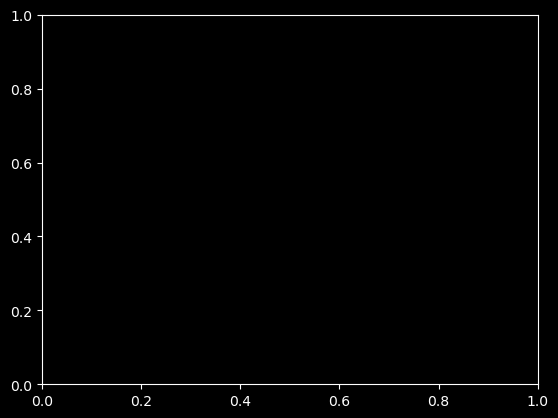

In [198]:
unit=869
df1 = df_units[df_units.probe=='A'][df_units.label==2]
f,ax=plt.subplots(1,1)
psth.psth_line(times=df1[df1.index==unit].spike_times.values[0],
         triggers=df_stim[(df_stim.stimulus=='luminance_flash') & (df_stim.optogenetics_LED_state == 0)].start_time.values[::2],
              ymax=60,binsize=0.05,axes=ax,color='#487697')
psth.psth_line(times=df1[df1.index==unit].spike_times.values[0],
         triggers=df_stim[(df_stim.stimulus=='luminance_flash_opto') ].start_time.values[::2],
              ymax=60,binsize=0.05,axes=ax,color='#ffaa00')
plt.tight_layout()
# f.savefig('/Users/danieljdenman/Academics/grants/applications/20230305_R01_NEI_resub/figures/eArch_LM_psth.eps')
# f.savefig('/Users/danieljdenman/Academics/grants/applications/20230305_R01_NEI_resub/figures/eArch_LM_psth.png')

f,ax=plt.subplots(2,1)
psth.raster(times=df1[df1.index==unit].spike_times.values[0],
         triggers=df_stim[(df_stim.stimulus=='luminance_flash') & (df_stim.optogenetics_LED_state == 0)].start_time.values[::2],
              axes=ax[0],color='#487697',timeDomain=True,post=1.5,ms=8)
psth.raster(times=df1[df1.index==unit].spike_times.values[0],
         triggers=df_stim[(df_stim.stimulus=='luminance_flash_opto') ].start_time.values[::2],
              axes=ax[1],color='#ffaa00',timeDomain=True,post=1.5,ms=8)
for ax_ in ax: ax_.set_xlim(-0.5,1.0)
plt.tight_layout()
# f.savefig('/Users/danieljdenman/Academics/grants/applications/20230305_R01_NEI_resub/figures/eArch_LM_raster.eps')

# .values[1::2]
### is Equal too the dark flashes

In [201]:
df_stim

,start_time,stop_time,stimulus,optogenetics_LED_state
id,,,,
0,33.866667,33.866667,pellet_detected_baseline,0
1,68.406667,68.406667,pellet_detected_baseline,0
2,87.660000,87.660000,pellet_detected_perturbation,0
3,121.840000,121.840000,pellet_detected_perturbation,0
4,156.620000,156.620000,pellet_detected_washout,0
...,...,...,...,...
69841,232.826667,232.826667,frames_in_seconds_openEphys,0
69842,232.833333,232.833333,frames_in_seconds_openEphys,0
69843,232.840000,232.840000,frames_in_seconds_openEphys,0


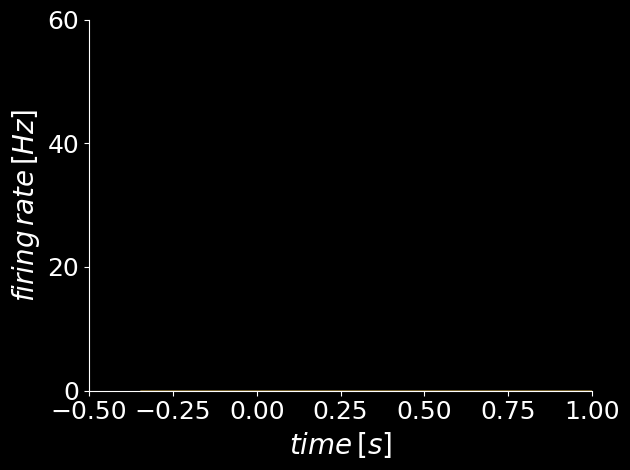

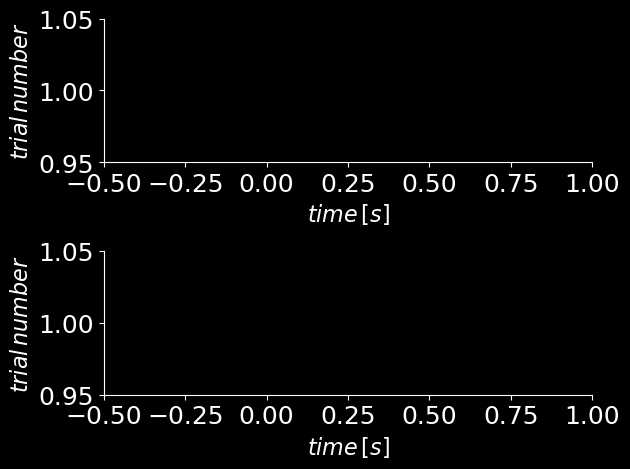

In [206]:
unit=1
df1 = df_units[df_units.probe=='A'][df_units.label==2]
f,ax=plt.subplots(1,1)
psth.psth_line(times=df1[df1.index==unit].spike_times.values[0],
         triggers=df_stim[(df_stim.stimulus=='pellet_detected_baseline') & (df_stim.optogenetics_LED_state == 0)].start_time.values[1::2],
              ymax=60,binsize=0.05,axes=ax,color='#487697')
psth.psth_line(times=df1[df1.index==unit].spike_times.values[0],
         triggers=df_stim[(df_stim.stimulus=='pellet_detected_perturbation') ].start_time.values[1::2],
              ymax=60,binsize=0.05,axes=ax,color='#ffaa00')
plt.tight_layout()
# f.savefig('/Users/danieljdenman/Academics/grants/applications/20230305_R01_NEI_resub/figures/eArch_LM_psth.eps')
# f.savefig('/Users/danieljdenman/Academics/grants/applications/20230305_R01_NEI_resub/figures/eArch_LM_psth.png')

f,ax=plt.subplots(2,1)
psth.raster(times=df1[df1.index==unit].spike_times.values[0],
         triggers=df_stim[(df_stim.stimulus=='pellet_detected_baseline') & (df_stim.optogenetics_LED_state == 0)].start_time.values[1::2],
              axes=ax[0],color='#487697',timeDomain=True,post=1.5,ms=8)
psth.raster(times=df1[df1.index==unit].spike_times.values[0],
         triggers=df_stim[(df_stim.stimulus=='pellet_detected_perturbation') ].start_time.values[1::2],
              axes=ax[1],color='#ffaa00',timeDomain=True,post=1.5,ms=8)
for ax_ in ax: ax_.set_xlim(-0.5,1.0)
plt.tight_layout()
# f.savefig('/Users/danieljdenman/Academics/grants/applications/20230305_R01_NEI_resub/figures/eArch_LM_raster.eps')